

---


**Grupo 1:** Ignacio de Lecea, Alejandra Llord, Diego Hermana, Ana Robledano e Ignacio López.

**Grado:** Ingeniería Matemática.

**Asignatura:** Deep Learning.

**Curso:** 4ºB






# PRÁCTICA 1


---
Esta práctica consiste en desarrollador diferentes modelos capaces de reconocer una especio marina representada en una imagen. Para poder construir este tipo de modelos es necesarios utilizar redes convolucionales profundas, las cuales nos permiten extraer las características de las imágenes a través de la información recogida en los píxeles.

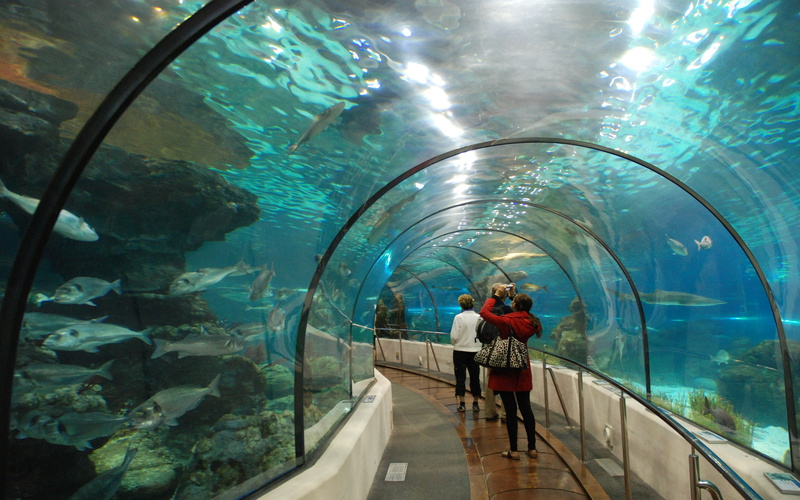

---



##**Fase 1** - Preparación del entorno

Crea un notebook llamado PW1_red_1_n.ipynb (donde n se corresponde con el identificador del grupo) en el servidor de notebooks de tu elección (Colab, Jupyter, etc.).

1. Crea un notebook llamado PW1_red_2_n.ipynb (donde n se corresponde con el identificador del grupo) en el servidor de notebooks de tu elección (Colab, Jupyter, etc.).
Descargar el dataset Download datasetcon las imágenes referentes a los ejemplos.

2. Examina el conjunto de datos para identificar las diferentes clases.

3. Prepara el conjunto de datos para el entrenamiento, transformando/escalando las características y los valores de las clases (si es necesario).

4. Construir un algoritmo que permita agrupar los diferentes ejemplos disponibles en los datasets de entrenamiento, test y validación en clases mediante carpetas. Para poder realizar esta operación se dispone de fichero annotations.csv donde se indica para cada imagen la clase que le corresponde.

**IMPORTANTE: El conjunto de datos de entrenamiento debe ser el mismo para ambos procesos de entrenamiento.**



Importación de librerías al entorno de trabajo:

In [1]:
import os
import zipfile
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil

Descompresión del dataset y organización de carpetas:

In [2]:
# Ruta del archivo ZIP y carpeta destino
local_zip = "/content/practica_1_dataset.zip"
extract_folder = "./dataset"

# Descomprimir el archivo ZIP
with zipfile.ZipFile(local_zip, 'r') as zip_ref:
    zip_ref.extractall(extract_folder)

print("Descompresión completada.")

# Definir rutas de carpetas
train_dir = os.path.join(extract_folder, 'train') # /content/dataset/train
test_dir = os.path.join(extract_folder, 'test')
valid_dir = os.path.join(extract_folder, 'valid')

# Verificar existencia de directorios
if os.path.exists(train_dir) and os.path.exists(test_dir):
    print(f"Directorio de entrenamiento encontrado: {train_dir}")
    print(f"Directorio de prueba encontrado: {test_dir}")
    print(f"Directorio de validación encontrado: {valid_dir}")
else:
    raise FileNotFoundError("ERROR: Verifica que el ZIP contiene 'train/' y 'test/' correctamente.")

Descompresión completada.
Directorio de entrenamiento encontrado: ./dataset/train
Directorio de prueba encontrado: ./dataset/test
Directorio de validación encontrado: ./dataset/valid


__Nota__: se debe subir manualmente el dataset en formato zip.

## **Examinación del conjunto de datos:**

Veamos cuántas imágenes hay en cada carpeta.

In [3]:
folders = ["train", "test", "valid"]
total = 0 # Para contar el número de imágenes totales

# Contar imágenes en cada carpeta
for folder in folders:
    folder_path = os.path.join(extract_folder, folder)
    if os.path.exists(folder_path):
        num_images = len([f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))])
        print(f"📂 {folder}: {num_images} imágenes")
        total = total + num_images
    else:
        print(f"🚨 La carpeta '{folder}' no existe.")

print(f"-------------------------\nTotal de imágenes: {total}")

📂 train: 448 imágenes
📂 test: 63 imágenes
📂 valid: 127 imágenes
-------------------------
Total de imágenes: 638


Cada carpeta (`train`,`test` y `val`) contiene imágenes en formato .jpg y un csv de anotaciones. Por ejemplo:

📂 La carpeta `val` contiene:
* 63 imágenes .jpeg

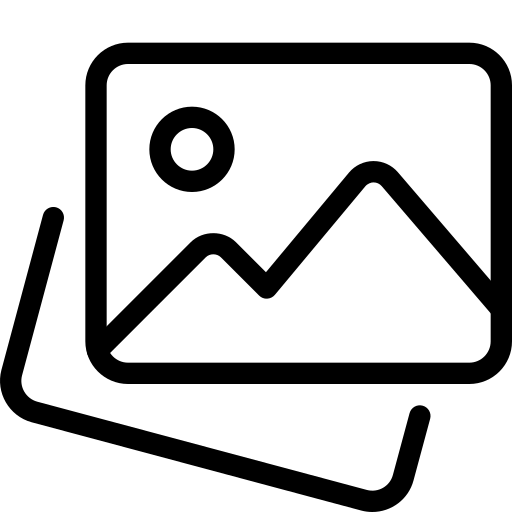

* Y un archivo `annotations.csv`:

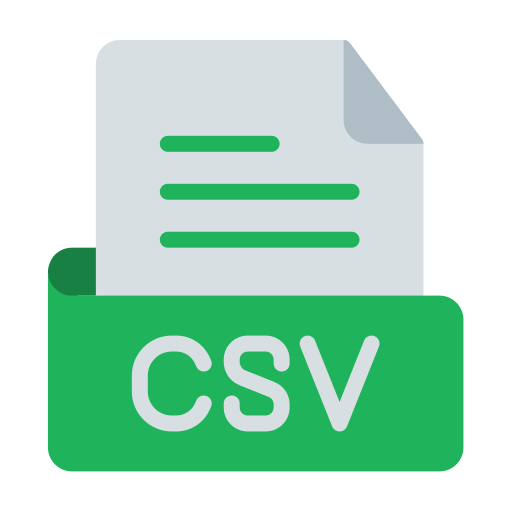

Se recomienda que los datos de validación supongan entre un `5-10%` del número de datos totales. En este caso los datos de validación son aproximadamente el `10%` del total.

A continuación se muestran las distintas clases del dataset y la distribución que siguen (nº de imágenes de cada clase).

In [71]:
# Inicializar un diccionario vacío para acumular los conteos
class_totals = pd.Series(dtype=int)
for folder in folders:
  # Cargar el CSV
  csv_path = "/content/dataset/" + folder + "/annotations.csv"
  df = pd.read_csv(csv_path)
  # Contar clases únicas y su frecuencia
  class_counts = df["class"].value_counts()
  # Sumar directamente los conteos
  class_totals = class_totals.add(class_counts, fill_value=0)
  # Mostrar resultados
  print(f"📂 {folder}")
  print("--------------------------------------------------------")
  print(class_counts)
  print("--------------------------------------------------------")



📂 train
--------------------------------------------------------
class
fish         1961
jellyfish     385
penguin       330
shark         259
puffin        175
stingray      136
starfish       78
Name: count, dtype: int64
--------------------------------------------------------
📂 test
--------------------------------------------------------
class
fish         249
jellyfish    154
penguin       82
shark         38
puffin        35
stingray      15
starfish      11
Name: count, dtype: int64
--------------------------------------------------------
📂 valid
--------------------------------------------------------
class
fish         459
jellyfish    155
penguin      104
puffin        74
shark         57
stingray      33
starfish      27
Name: count, dtype: int64
--------------------------------------------------------


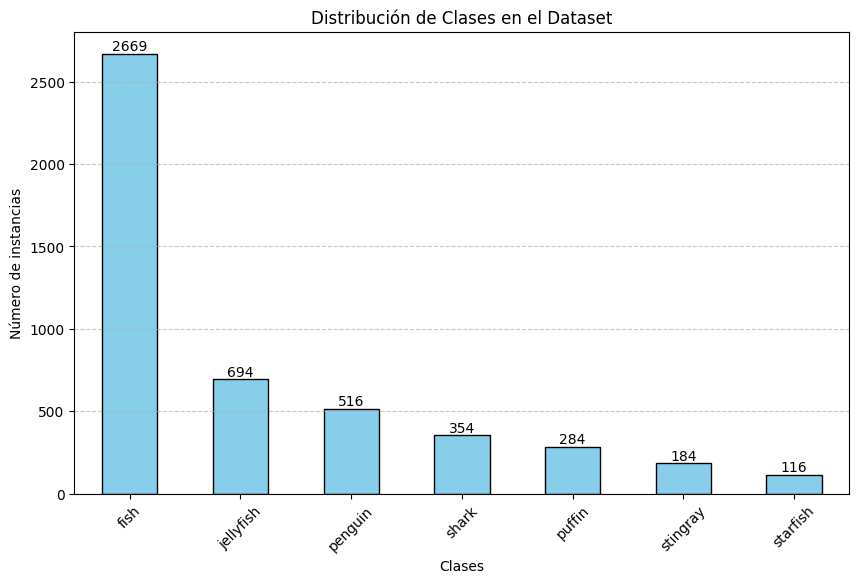

In [70]:
# Ordenar los resultados de mayor a menor
class_totals = class_totals.sort_values(ascending=False)

# Graficar
plt.figure(figsize=(10, 6))
class_totals.plot(kind="bar", color="skyblue", edgecolor="black")
plt.xlabel("Clases")
plt.ylabel("Número de instancias")
plt.title("Distribución de Clases en el Dataset")
plt.xticks(rotation=45)
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Mostrar valores encima de cada barra
for i, v in enumerate(class_totals):
    plt.text(i, v + 20, str(int(v)), ha="center", fontsize=10)

plt.show()

Hay una distribución muy desequilibrada del dataset. Como la mayoría de imágenes son de peces, el modelo puede resultar sesgado, clasificando todas las imágenes como pertenecientes a la clase peces, y tener una buena `accuracy`.

Para solucionar este problema se podría hacer un aumento (rotando o distorsionando) de las imágenes de las clases con menos instancias como `starfish`.

El `csv` tiene este formato de columnas:

In [6]:
df.head(2)

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG_2398_jpeg_jpg.rf.000bc0bd92988307264de7019...,768,1024,fish,635,54,767,276
1,IMG_2398_jpeg_jpg.rf.000bc0bd92988307264de7019...,768,1024,fish,228,479,538,753


**Nota:** este dataFrame contiene `annotations.csv` de la carpeta 📂`valid`. Mostramos un ejemplo de prueba.

In [7]:
example_filename = df['filename'][0]
example_class = df['class'][0]

Si queremos imprimir del dataset de validación la primera imagen y su clase utilizamos el PATH: `valid_dir` +  `example_filename` que es el primer registro del `df`.

In [8]:
example_filename

'IMG_2398_jpeg_jpg.rf.000bc0bd92988307264de7019fca4b57.jpg'

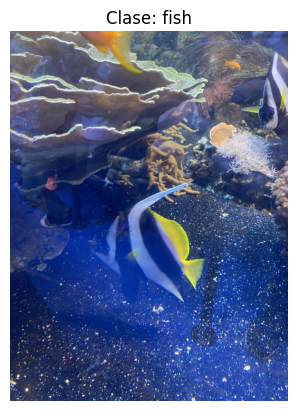

In [9]:
img_path = valid_dir + '/' + example_filename
img = mpimg.imread(img_path)  # Leer la imagen

# Mostrar la imagen
plt.title(f'Clase: {example_class}')  # Agregar la clase en la leyenda
plt.imshow(img)
plt.axis('off')  # Desactivar ejes
plt.show()


A continuación, vamos a separar las imágenes en carpetas según su clase, la clase viene apuntada en `annotations.csv` de cada carpeta (`train`, `val` y `test`).

In [10]:
classes = df["class"].unique()
print(classes)
for folder in folders:
  folder_path = os.path.join(extract_folder, folder)
  for class_name in classes:
      class_folder = os.path.join(folder_path, class_name)
      os.makedirs(class_folder, exist_ok=True)

['fish' 'shark' 'starfish' 'jellyfish' 'penguin' 'stingray' 'puffin']


In [11]:
for folder in folders:
  folder_path = os.path.join(extract_folder, folder)
  # Cargar el CSV
  csv_path = os.path.join(folder_path, "annotations.csv")
  df = pd.read_csv(csv_path)
  # Mover las imágenes a sus respectivas carpetas
  for _, row in df.iterrows():
      img_filename = row["filename"]
      class_name = row["class"]

      img_path = os.path.join(folder_path, img_filename)
      new_img_path = os.path.join(folder_path, class_name, img_filename)

      if os.path.exists(img_path):  # Verificar si la imagen existe antes de moverla
          shutil.move(img_path, new_img_path)
      else:
          print(f"Folder: {folder_path}")
          print(f"❌ Imagen no encontrada: {img_filename}")

print("✅ Imágenes organizadas por clase correctamente.")


Se han truncado las últimas 5000 líneas del flujo de salida.
❌ Imagen no encontrada: IMG_8551_MOV-4_jpg.rf.f3784ce90069a27a41d01dbc9f7d53cb.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8551_MOV-4_jpg.rf.f3784ce90069a27a41d01dbc9f7d53cb.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8517_MOV-1_jpg.rf.f38c10686e4a0e257b1f2d8f4bb5f4b1.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8517_MOV-1_jpg.rf.f38c10686e4a0e257b1f2d8f4bb5f4b1.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8517_MOV-1_jpg.rf.f38c10686e4a0e257b1f2d8f4bb5f4b1.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8517_MOV-1_jpg.rf.f38c10686e4a0e257b1f2d8f4bb5f4b1.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_8517_MOV-1_jpg.rf.f38c10686e4a0e257b1f2d8f4bb5f4b1.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_2561_jpeg_jpg.rf.f50a9915e352436894ae2749e4df115a.jpg
Folder: ./dataset/train
❌ Imagen no encontrada: IMG_2561_jpeg_jpg.rf.f50a9915e352436894ae2749e4df115a.jpg
Fo

Prepara el conjunto de datos para el entrenamiento, transformando/escalando las características y los valores de las clases (si es necesario).

In [74]:
# We create an image generator with augmentation
train_datagen = ImageDataGenerator(
      # We scale pixels between 0 and 1
      rescale = 1./255,
      rotation_range = 30,
      width_shift_range = 0.2,
      height_shift_range = 0.2,
      shear_range = 0.2,
      zoom_range = 0.2,
      horizontal_flip = True,
      fill_mode = 'nearest')

# Flow training images in batches of 128 using train_datagen generator
train_generator = train_datagen.flow_from_directory(
        # We define the directory where the training images are located.
        '/content/dataset/train',
        # We transform all images to 96 x 96.
        target_size=(96, 96),
        # We group the images into batches of 128.
        batch_size=64,
        # We specify that the images remain in color (RGB).
        color_mode="rgb",
        # We define a categorical class type.
        class_mode='categorical')

test_datagen = ImageDataGenerator(
    rescale = 1/255)

test_generator = test_datagen.flow_from_directory(
        # We define the directory where the test images are located.
        '/content/dataset/test',
        # We transform all images to 96 x 96.
        target_size = (96, 96),
        # We specify that the images remain in color (RGB).
        color_mode = "rgb",
        # We define a categorical class type.
        class_mode = 'categorical')

val_datagen = ImageDataGenerator(rescale=1./255)

val_generator = val_datagen.flow_from_directory(
    '/content/dataset/valid',  # carpeta con las imágenes de validación organizadas por clase
    target_size=(96, 96),
    color_mode='rgb',
    batch_size=64,
    class_mode='categorical'
)


Found 447 images belonging to 7 classes.
Found 63 images belonging to 7 classes.
Found 127 images belonging to 7 classes.


## **Fase 2** - Implementación en modo Pre-Train

Desarrollar una Red Neuronal Convolucional profunda en el notebook denominado `PW1_red_1_n.ipynb` utilizando el framework Keras, cumpliendo con las siguientes especificaciones:

* Debe incluir al menos 3 capas convolucionales.

* Debe utilizar ReLU como función de activación.

* Debe utilizar la función softmax para la salida de la última capa.

* Debe utilizar la función categorical crossentropy como función de pérdida.

* Debe utilizar el algoritmo RMSprop para minimizar la función de pérdida.

Una vez definida la red, se deberán implementar tres configuraciones diferentes para los tamaños de kernel, tamaños de pooling, número de capas y tasa de aprendizaje (learning rate) para ejecutar el proceso de entrenamiento.

Selecciona el mejor de los tres modelos justificando tu elección mediante la utilización de diferentes métricas de bondad.

Dibuja la matriz de confusión del conjunto de entrenamiento.

Dibuja un gráfico que muestra la variación de la pérdida (error) en función de las épocas para el conjunto de entrenamiento.

Dibuja la arquitectura de la red correspondiente a la red seleccionada.

---

Para la fase 2 se necesitan las siguientes librerías

In [13]:
from google.colab import files

from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img

from keras.callbacks import TensorBoard
from keras.preprocessing import image
import keras
import numpy as np
import tensorflow as tf
import os
import zipfile
import matplotlib.pyplot as plt
import numpy as np
import random


In [75]:
# Crear directorio para guardar los modelos entrenados
save_dir = "saved_models"
os.makedirs(save_dir, exist_ok=True)

# Almacenar los históricos de entrenamiento
histories = []
models = []
log_dirs = []

Definimos las capas:


In [76]:
# Define hyperparameters
kernel_sizes = [(4,4), (5,5), (3,3)]
pool_sizes = [(3,3), (2,2), (2,2)]
learning_rates = [0.01, 0.005, 0.0001]
dense_configs = [128, 256, 512]
epochs = [10, 3, 3]
input_size = 96
num_colors = 3

# Train models with different configurations
for i in range(1):
    print(f"\nTraining model {i+1} with LR={learning_rates[i]}, Kernel={kernel_sizes[i]}, Pool={pool_sizes[i]}, Dense={dense_configs[i]}")
    model = keras.Sequential()

    # Input layer
    model.add(keras.layers.Conv2D(16, kernel_sizes[i], activation='relu', input_shape=(input_size, input_size, num_colors)))
    model.add(keras.layers.MaxPooling2D(pool_sizes[i]))

    # Common layers
    model.add(keras.layers.Conv2D(32, kernel_sizes[i], activation='relu'))
    model.add(keras.layers.MaxPooling2D(pool_sizes[i]))
    model.add(keras.layers.Conv2D(32, kernel_sizes[i], activation='relu'))
    model.add(keras.layers.MaxPooling2D(pool_sizes[i]))

    # Only in configurations 2 and 3
    if i >= 1:
        model.add(keras.layers.Conv2D(64, kernel_sizes[i], activation='relu'))
        model.add(keras.layers.MaxPooling2D(pool_sizes[i]))

    # Only in configuration 3
    if i == 2:  # Change this to i == 2 instead of i == 4
        model.add(keras.layers.Conv2D(128, kernel_sizes[i], activation='relu'))
        model.add(keras.layers.MaxPooling2D(pool_sizes[i]))

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(dense_configs[i], activation='relu'))
    model.add(keras.layers.Dense(7, activation='softmax'))  # Assuming 7 output classes

    optimizer = keras.optimizers.RMSprop(learning_rate=learning_rates[i])
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

    # TensorBoard logs
    log_dir = os.path.join("logs", f"model_{i+1}")
    tensorboard_callback = keras.callbacks.TensorBoard(log_dir=log_dir)

    # Train the model
    history = model.fit(train_generator, epochs=epochs[i], validation_data=val_generator, callbacks=[tensorboard_callback])

    # Guardar el modelo entrenado, el histórico y el log_dir
    models.append(model)
    histories.append(history)
    log_dirs.append(log_dir)


Training model 1 with LR=0.01, Kernel=(4, 4), Pool=(3, 3), Dense=128


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.2352 - loss: 4.4571 - val_accuracy: 0.0866 - val_loss: 1.9293
Epoch 2/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step - accuracy: 0.2240 - loss: 1.8860 - val_accuracy: 0.3701 - val_loss: 1.8527
Epoch 3/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 854ms/step - accuracy: 0.3717 - loss: 1.8073 - val_accuracy: 0.3701 - val_loss: 1.8165
Epoch 4/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 8s 1s/step - accuracy: 0.3722 - loss: 1.7681 - val_accuracy: 0.3701 - val_loss: 1.8075
Epoch 5/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 7s 971ms/step - accuracy: 0.3675 - loss: 1.7778 - val_accuracy: 0.3701 - val_loss: 1.8101
Epoch 6/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 10s 852ms/step - accuracy: 0.3331 - loss: 1.7931 - val_accuracy: 0.3701 - val_loss: 1.8073
Epoch 7/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step - accuracy: 0.3398 - loss: 1.7950 - val_accuracy: 0.3701 - val_loss: 1.8083
Epoch 8/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 850ms/step - accuracy: 0.3443 - loss: 1.7890 - val_accuracy: 0.3701 - val_loss: 1.8033
Ep

In [41]:
%load_ext tensorboard


In [46]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 44728), started 0:03:21 ago. (Use '!kill 44728' to kill it.)

<IPython.core.display.Javascript object>


Arquitectura del modelo 1:


Model: "sequential_46"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_166 (Conv2D)                  │ (None, 93, 93, 16)          │             784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_163 (MaxPooling2D)     │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_167 (Conv2D)                  │ (None, 28, 28, 32)          │           8,224 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_164 (MaxPooling2D)     │ (None, 9, 9, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_168 (Conv2D)                  │ (None, 6, 6, 32)            │          16,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_165 (MaxPooling2D)     │ (None, 2, 2, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_43 (Flatten)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_87 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_88 (Dense)                     │ (None, 7)                   │             903 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 85,680 (334.69 KB)

 Trainable params: 42,839 (167.34 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 42,841 (167.35 KB)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 305ms/step


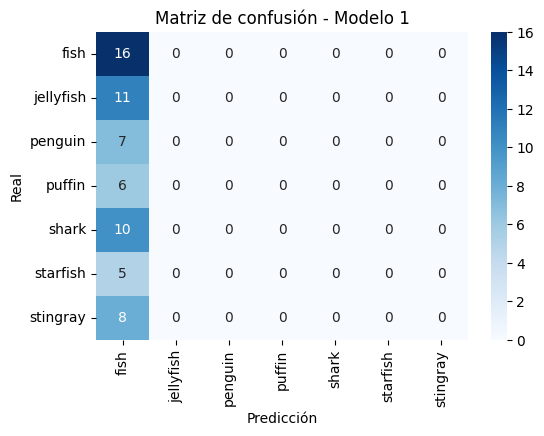


Reporte de clasificación para el Modelo 1:
              precision    recall  f1-score   support

        fish       0.25      1.00      0.41        16
   jellyfish       0.00      0.00      0.00        11
     penguin       0.00      0.00      0.00         7
      puffin       0.00      0.00      0.00         6
       shark       0.00      0.00      0.00        10
    starfish       0.00      0.00      0.00         5
    stingray       0.00      0.00      0.00         8

    accuracy                           0.25        63
   macro avg       0.04      0.14      0.06        63
weighted avg       0.06      0.25      0.10        63



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


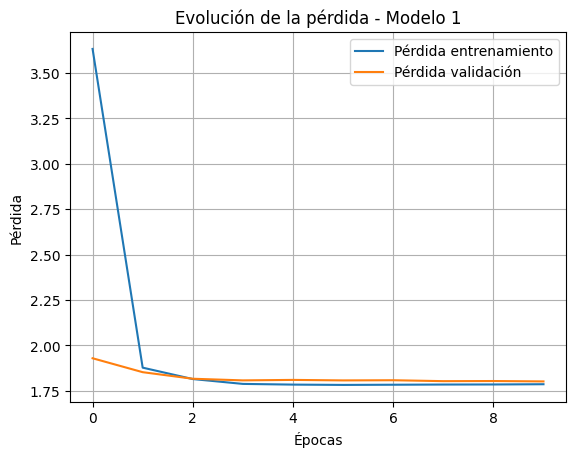


Usando TensorBoard para visualizar las métricas del modelo 1


Reusing TensorBoard on port 6006 (pid 50213), started 0:52:40 ago. (Use '!kill 50213' to kill it.)

<IPython.core.display.Javascript object>

In [77]:
# 1. Mostrar la arquitectura de los modelos
for i, model in enumerate(models):
    print(f"\nArquitectura del modelo {i+1}:")
    model.summary()

# 2. Predicciones y matrices de confusión
for i, model in enumerate(models):
    y_pred_probs = model.predict(test_generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    y_true = test_generator.classes
    class_names = list(test_generator.class_indices.keys())

    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Matriz de confusión - Modelo {i+1}")
    plt.xlabel("Predicción")
    plt.ylabel("Real")
    plt.show()

    # Reporte de clasificación (comentado si no lo deseas)
    print(f"\nReporte de clasificación para el Modelo {i+1}:")
    print(classification_report(y_true, y_pred, target_names=class_names))


# 3. Evolución de la pérdida
for i, history in enumerate(histories):
    plt.plot(history.history['loss'], label='Pérdida entrenamiento')
    plt.plot(history.history['val_loss'], label='Pérdida validación')
    plt.title(f"Evolución de la pérdida - Modelo {i+1}")
    plt.xlabel("Épocas")
    plt.ylabel("Pérdida")
    plt.legend()
    plt.grid(True)
    plt.show()

# 4. TensorBoard logs
for i, log_dir in enumerate(log_dirs):
    print(f"\nUsando TensorBoard para visualizar las métricas del modelo {i+1}")
    %tensorboard --logdir logs


In [43]:
# Borra recursivamente las carpetas train, test y logs si existen
#!rm -rf train/
#!rm -rf test/
# !rm -rf logs/


 Arquitectura del modelo 1:


Model: "sequential_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_144 (Conv2D)                  │ (None, 93, 93, 16)          │             784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_141 (MaxPooling2D)     │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_145 (Conv2D)                  │ (None, 28, 28, 32)          │           8,224 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_142 (MaxPooling2D)     │ (None, 9, 9, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_146 (Conv2D)                  │ (None, 6, 6, 32)            │          16,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_143 (MaxPooling2D)     │ (None, 2, 2, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_37 (Flatten)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_75 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_76 (Dense)                     │ (None, 7)                   │             903 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 85,680 (334.69 KB)

 Trainable params: 42,839 (167.34 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 42,841 (167.35 KB)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


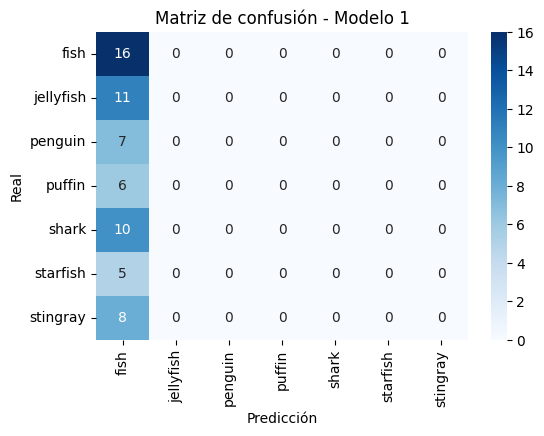


 Métricas del modelo 1:


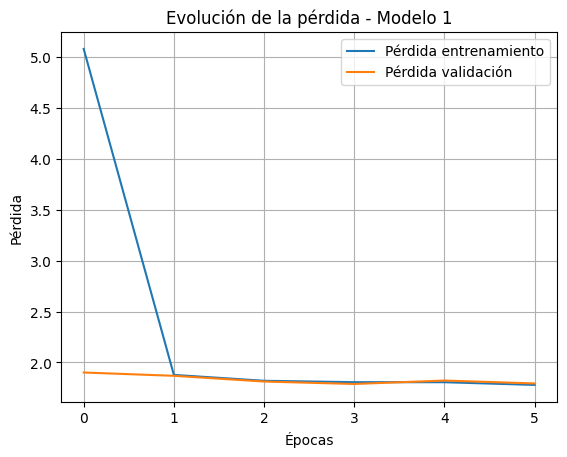

In [61]:
    print(f"\n Arquitectura del modelo {i+1}:")
    model.summary()

    # === Predicciones y matriz de confusión ===
    y_pred_probs = model.predict(test_generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    y_true = test_generator.classes
    class_names = list(test_generator.class_indices.keys())

    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6,4))
    sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Matriz de confusión - Modelo {i+1}")
    plt.xlabel("Predicción")
    plt.ylabel("Real")
    plt.show()

    # === Métricas de bondad ===
    print(f"\n Métricas del modelo {i+1}:")
    #print(classification_report(y_true, y_pred, target_names=class_names))

    # === Evolución de la pérdida ===
    plt.plot(history.history['loss'], label='Pérdida entrenamiento')
    plt.plot(history.history['val_loss'], label='Pérdida validación')
    plt.title(f"Evolución de la pérdida - Modelo {i+1}")
    plt.xlabel("Épocas")
    plt.ylabel("Pérdida")
    plt.legend()
    plt.grid(True)
    plt.show()

Se definen 3 configuraciones distintas para el entrenamiento:


 Cargando modelo 1 desde saved_models/model_1.keras...

 Arquitectura del modelo 1:


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)                    │ (None, 94, 94, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 47, 47, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 45, 45, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 22, 22, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 20, 20, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 10, 10, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 6400)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │         819,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 7)                   │             903 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,687,632 (6.44 MB)

 Trainable params: 843,815 (3.22 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 843,817 (3.22 MB)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 409ms/step


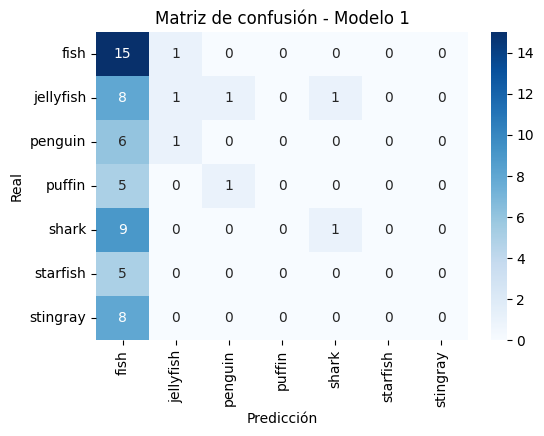


 Métricas del modelo 1:
              precision    recall  f1-score   support

        fish       0.27      0.94      0.42        16
   jellyfish       0.33      0.09      0.14        11
     penguin       0.00      0.00      0.00         7
      puffin       0.00      0.00      0.00         6
       shark       0.50      0.10      0.17        10
    starfish       0.00      0.00      0.00         5
    stingray       0.00      0.00      0.00         8

    accuracy                           0.27        63
   macro avg       0.16      0.16      0.10        63
weighted avg       0.21      0.27      0.16        63

No se encontró historial de entrenamiento para el modelo 1

 Cargando modelo 2 desde saved_models/model_2.keras...

 Arquitectura del modelo 2:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)                    │ (None, 92, 92, 16)          │           1,216 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 46, 46, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 42, 42, 32)          │          12,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_7 (MaxPooling2D)       │ (None, 21, 21, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_8 (Conv2D)                    │ (None, 17, 17, 64)          │          51,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_8 (MaxPooling2D)       │ (None, 8, 8, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 4096)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │       1,048,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 7)                   │             903 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,295,888 (8.76 MB)

 Trainable params: 1,147,943 (4.38 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 1,147,945 (4.38 MB)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 185ms/step


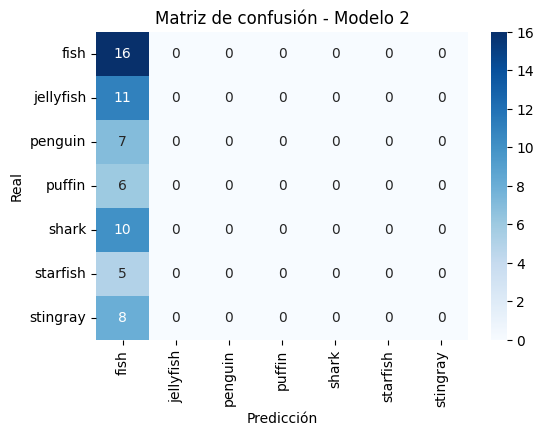


 Métricas del modelo 2:
              precision    recall  f1-score   support

        fish       0.25      1.00      0.41        16
   jellyfish       0.00      0.00      0.00        11
     penguin       0.00      0.00      0.00         7
      puffin       0.00      0.00      0.00         6
       shark       0.00      0.00      0.00        10
    starfish       0.00      0.00      0.00         5
    stingray       0.00      0.00      0.00         8

    accuracy                           0.25        63
   macro avg       0.04      0.14      0.06        63
weighted avg       0.06      0.25      0.10        63

No se encontró historial de entrenamiento para el modelo 2

 Cargando modelo 3 desde saved_models/model_3.keras...

 Arquitectura del modelo 3:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_9 (Conv2D)                    │ (None, 94, 94, 16)          │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_9 (MaxPooling2D)       │ (None, 31, 31, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_10 (Conv2D)                   │ (None, 29, 29, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_10 (MaxPooling2D)      │ (None, 9, 9, 32)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_11 (Conv2D)                   │ (None, 7, 7, 64)            │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_11 (MaxPooling2D)      │ (None, 2, 2, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 512)                 │         131,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 7)                   │             903 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 640,592 (2.44 MB)

 Trainable params: 320,295 (1.22 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 320,297 (1.22 MB)

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 208ms/step


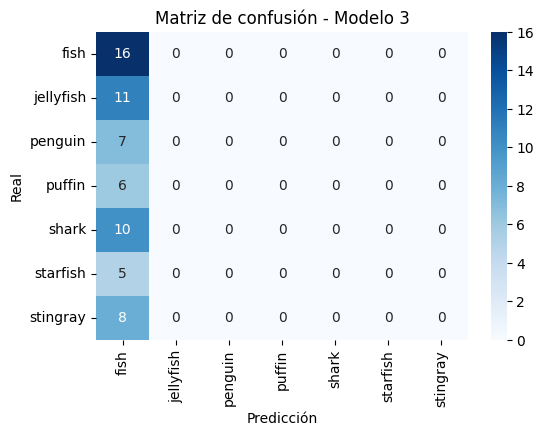


 Métricas del modelo 3:
              precision    recall  f1-score   support

        fish       0.25      1.00      0.41        16
   jellyfish       0.00      0.00      0.00        11
     penguin       0.00      0.00      0.00         7
      puffin       0.00      0.00      0.00         6
       shark       0.00      0.00      0.00        10
    starfish       0.00      0.00      0.00         5
    stingray       0.00      0.00      0.00         8

    accuracy                           0.25        63
   macro avg       0.04      0.14      0.06        63
weighted avg       0.06      0.25      0.10        63

No se encontró historial de entrenamiento para el modelo 3


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [21]:
from keras.models import load_model
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Directorio donde están los modelos guardados
save_dir = "saved_models"
num_models = 3  # Número de modelos guardados

# Evaluamos cada modelo guardado
for i in range(num_models):
    model_path = os.path.join(save_dir, f"model_{i+1}.keras")
    print(f"\n Cargando modelo {i+1} desde {model_path}...")

    # Cargar modelo guardado
    model = load_model(model_path)

    print(f"\n Arquitectura del modelo {i+1}:")
    model.summary()

    # === Predicciones y matriz de confusión ===
    y_pred_probs = model.predict(test_generator)
    y_pred = np.argmax(y_pred_probs, axis=1)
    y_true = test_generator.classes
    class_names = list(test_generator.class_indices.keys())

    # Matriz de confusión
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Matriz de confusión - Modelo {i+1}")
    plt.xlabel("Predicción")
    plt.ylabel("Real")
    plt.show()

    # === Métricas de bondad ===
    print(f"\n Métricas del modelo {i+1}:")
    print(classification_report(y_true, y_pred, target_names=class_names))

    # === Evolución de la pérdida ===
    history_path = os.path.join("logs", f"modelo_{i+1}", "history.npy")

    if os.path.exists(history_path):
        history = np.load(history_path, allow_pickle=True).item()

        plt.plot(history['loss'], label='Pérdida entrenamiento')
        plt.plot(history['val_loss'], label='Pérdida validación')
        plt.title(f"Evolución de la pérdida - Modelo {i+1}")
        plt.xlabel("Épocas")
        plt.ylabel("Pérdida")
        plt.legend()
        plt.grid(True)
        plt.show()
    else:
        print(f"No se encontró historial de entrenamiento para el modelo {i+1}")
